## load data 

### load train data

In [ ]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import os 
IMG_SIZE=224
DATADIR="/content/drive/My Drive/HIGHMIDCHANCEGLAUMYOPIAmaculopathyRP/TRAIN"
CATEGORIES=["healthy","glaucoma","myopia","maculopathy","retinitispigmentosa"]

training_data=[]
def create_training_data():
  for category in CATEGORIES:
    path=os.path.join(DATADIR,category)
    class_num=CATEGORIES.index(category)
    print(category)
    for img in os.listdir(path):
      img_array = cv2.imread(os.path.join(path,img))
      img_array = cv2.cvtColor(img_array, cv2.COLOR_BGR2RGB) 
      new_array=cv2.resize(img_array,(IMG_SIZE,IMG_SIZE))
      training_data.append([new_array,class_num])
create_training_data()

healthy
glaucoma
myopia
maculopathy
retinitispigmentosa


In [ ]:
print(len(training_data))

202


In [ ]:
import random
random.shuffle(training_data)
for sample in training_data:
  print(sample[1])

3
3
3
0
0
2
3
3
3
3
0
0
0
4
4
3
3
1
0
2
4
3
3
1
4
2
2
3
2
1
2
1
2
1
1
2
2
0
1
3
0
0
2
3
4
1
1
0
3
0
2
1
1
0
1
2
0
3
2
1
3
0
3
3
2
1
3
1
1
4
1
4
1
1
3
1
1
2
0
1
2
3
1
2
1
3
3
3
4
1
1
2
3
3
1
1
3
0
3
3
0
4
0
2
3
2
3
1
2
2
1
1
3
3
1
2
3
1
3
1
3
1
1
4
3
2
3
3
2
2
1
3
1
4
2
1
3
4
3
3
0
1
4
3
1
1
4
3
2
3
1
1
2
1
3
3
0
0
3
0
4
3
3
1
0
3
2
4
2
1
2
4
1
1
1
1
1
1
2
0
1
2
3
2
2
0
1
3
4
1
3
2
1
2
1
2
0
2
1
1
3
3


In [ ]:
x=[]
y=[]
for features, label in training_data:
  x.append(features)
  y.append(label)
x=np.array(x).reshape(-1,IMG_SIZE,IMG_SIZE,3)
X=x/255.0
Y=np.array(y)
print(Y)

[3 3 3 0 0 2 3 3 3 3 0 0 0 4 4 3 3 1 0 2 4 3 3 1 4 2 2 3 2 1 2 1 2 1 1 2 2
 0 1 3 0 0 2 3 4 1 1 0 3 0 2 1 1 0 1 2 0 3 2 1 3 0 3 3 2 1 3 1 1 4 1 4 1 1
 3 1 1 2 0 1 2 3 1 2 1 3 3 3 4 1 1 2 3 3 1 1 3 0 3 3 0 4 0 2 3 2 3 1 2 2 1
 1 3 3 1 2 3 1 3 1 3 1 1 4 3 2 3 3 2 2 1 3 1 4 2 1 3 4 3 3 0 1 4 3 1 1 4 3
 2 3 1 1 2 1 3 3 0 0 3 0 4 3 3 1 0 3 2 4 2 1 2 4 1 1 1 1 1 1 2 0 1 2 3 2 2
 0 1 3 4 1 3 2 1 2 1 2 0 2 1 1 3 3]


In [ ]:
from sklearn.preprocessing import OneHotEncoder,LabelEncoder

label_encoder = LabelEncoder()
integer_encoded = label_encoder.fit_transform(Y)
print(integer_encoded)

onehot_encoder = OneHotEncoder(sparse=False)
integer_encoded = integer_encoded.reshape(len(integer_encoded), 1)
onehot_encoded = onehot_encoder.fit_transform(integer_encoded)
print(onehot_encoded)


[3 3 3 0 0 2 3 3 3 3 0 0 0 4 4 3 3 1 0 2 4 3 3 1 4 2 2 3 2 1 2 1 2 1 1 2 2
 0 1 3 0 0 2 3 4 1 1 0 3 0 2 1 1 0 1 2 0 3 2 1 3 0 3 3 2 1 3 1 1 4 1 4 1 1
 3 1 1 2 0 1 2 3 1 2 1 3 3 3 4 1 1 2 3 3 1 1 3 0 3 3 0 4 0 2 3 2 3 1 2 2 1
 1 3 3 1 2 3 1 3 1 3 1 1 4 3 2 3 3 2 2 1 3 1 4 2 1 3 4 3 3 0 1 4 3 1 1 4 3
 2 3 1 1 2 1 3 3 0 0 3 0 4 3 3 1 0 3 2 4 2 1 2 4 1 1 1 1 1 1 2 0 1 2 3 2 2
 0 1 3 4 1 3 2 1 2 1 2 0 2 1 1 3 3]
[[0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0.]
 ...
 [0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0.]]


In [ ]:
Y=np.array(onehot_encoded)
print(Y)

[[0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0.]
 ...
 [0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0.]]


### load data test

In [ ]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import os 
IMG_SIZE=224
DATATestDIR="/content/drive/My Drive/HIGHMIDCHANCEGLAUMYOPIAmaculopathyRP/TEST"
CATEGORIES=["healthy","glaucoma","myopia","maculopathy","retinitispigmentosa"]

testing_data=[]
def create_testing_data():
  for category in CATEGORIES:
    path=os.path.join(DATATestDIR,category)
    class_num=CATEGORIES.index(category)
    for img in os.listdir(path):
      img_array = cv2.imread(os.path.join(path,img))
      img_array = cv2.cvtColor(img_array, cv2.COLOR_BGR2RGB) 
      new_array=cv2.resize(img_array,(IMG_SIZE,IMG_SIZE))
      testing_data.append([new_array,class_num])
create_testing_data()
print(len(testing_data))

48


In [ ]:
random.shuffle(testing_data)
for sample in testing_data[:10]:
  print(sample[1])

1
1
1
3
2
1
1
2
0
3


In [ ]:
xtest=[]
ytest=[]
for features, label in testing_data:
  ytest.append(label)
Ytest=np.array(ytest)
print(Ytest)

[1 1 1 3 2 1 1 2 0 3 2 1 2 1 0 2 3 1 3 3 1 1 3 1 1 3 1 3 3 3 2 4 3 3 4 1 0
 4 0 0 2 1 0 3 4 3 2 2]


## model

In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf

In [ ]:
image_batch=X[:4]

image_batch.shape

(4, 224, 224, 3)

In [ ]:
IMG_SHAPE = (IMG_SIZE, IMG_SIZE, 3)
tf.keras.backend.clear_session()
# Create the base model from the pre-trained model MobileNet V2
base_model = tf.keras.applications.MobileNetV2(input_shape=IMG_SHAPE,include_top=False,weights='imagenet')
feature_batch = base_model(image_batch)
print(feature_batch.shape)
base_model.trainable = False
global_average_layer = tf.keras.layers.GlobalAveragePooling2D()
feature_batch_average = global_average_layer(feature_batch)
print(feature_batch_average.shape)
prediction_layer = tf.keras.layers.Dense(5)

prediction_batch = prediction_layer(feature_batch_average)
print(prediction_batch.shape)
model = tf.keras.Sequential([
  base_model,
  global_average_layer,
  prediction_layer,
])
base_learning_rate = 0.1

model.compile(optimizer=tf.keras.optimizers.RMSprop(lr=base_learning_rate),
              loss=tf.keras.losses.CategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])
base_model.summary()
model.summary()
history = model.fit(X,Y,batch_size=4,epochs=16)

9412608/9406464 [==============================] - 0s 0us/step
(4, 7, 7, 1280)
(4, 1280)
(4, 5)
Model: "mobilenetv2_1.00_224"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
Conv1 (Conv2D)                  (None, 112, 112, 32) 864         input_1[0][0]                    
__________________________________________________________________________________________________
bn_Conv1 (BatchNormalization)   (None, 112, 112, 32) 128         Conv1[0][0]                      
__________________________________________________________________________________________________
Conv1_relu (ReLU)               (None, 112, 112, 32) 0           bn_Conv1[0][0]   

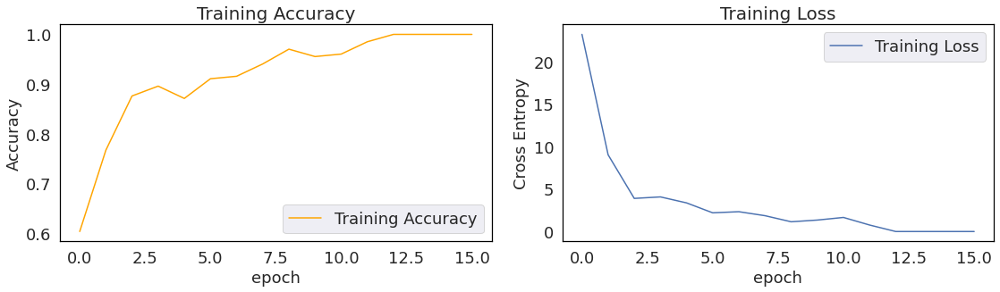

In [ ]:
acc = history.history['accuracy']
loss = history.history['loss']

fig,axes=plt.subplots(1,2,figsize=(16,5))
plt.rc('xtick',labelsize=8)


axes[0].plot(acc, label='Training Accuracy', color='#FFA500')
axes[0].tick_params(axis="x", labelsize=18)
axes[0].tick_params(axis="y", labelsize=18)

axes[0].legend(loc='lower right',fontsize=18)
axes[0].set_ylabel('Accuracy',fontsize=18)
axes[0].patch.set_facecolor("w")
axes[0].set_title('Training Accuracy',fontsize=20)
axes[0].set_xlabel('epoch',fontsize=18)
#axes[0].grid(None)

axes[0].spines['left'].set_color('black') 
axes[0].spines['bottom'].set_color('black') 
axes[0].spines['right'].set_color('black') 
axes[0].spines['top'].set_color('black')



axes[1].plot(loss, label='Training Loss')
axes[1].legend(loc='upper right',fontsize=18)
axes[1].set_ylabel('Cross Entropy',fontsize=18)
axes[1].patch.set_facecolor("w")
axes[1].set_title('Training Loss',fontsize=20)
axes[1].set_xlabel('epoch',fontsize=18)
#plt.grid(None)
axes[1].tick_params(axis="x", labelsize=18)
axes[1].tick_params(axis="y", labelsize=18)

axes[1].spines['left'].set_color('black') 
axes[1].spines['bottom'].set_color('black') 
axes[1].spines['right'].set_color('black') 
axes[1].spines['top'].set_color('black') 
plt.tight_layout()
plt.show()

## testing

In [ ]:
ytest=[]
xtest=[]
for features, label in testing_data:
  ytest.append(label)
  xtest.append(features)
xtest=np.array(xtest).reshape(-1,IMG_SIZE,IMG_SIZE,3)
Ytest=np.array(ytest)
Xtest=xtest/255.0
print(Ytest)

[1 1 1 3 2 1 1 2 0 3 2 1 2 1 0 2 3 1 3 3 1 1 3 1 1 3 1 3 3 3 2 4 3 3 4 1 0
 4 0 0 2 1 0 3 4 3 2 2]


In [ ]:

from tensorflow.keras.models import load_model

model.save("/content/drive/My Drive/MODEL/m10.fintuned.h5")

#model=load_model("/content/drive/My Drive/MODEL/m10.991.h5")


In [ ]:
from sklearn.metrics import multilabel_confusion_matrix

probability_model = tf.keras.Sequential([model,tf.keras.layers.Softmax()])
predictions = probability_model.predict(Xtest)
#print(predictions)


FINNAL_CLASIFICATION=[]
for r in predictions:
 c=np.argmax(r)
 FINNAL_CLASIFICATION.append(c)
FINNAL_CLASIFICATION=np.array(FINNAL_CLASIFICATION)
print(FINNAL_CLASIFICATION)
print(Ytest)
C = multilabel_confusion_matrix(Ytest, FINNAL_CLASIFICATION)

tp = C[:, 1, 1]
tn = C[:, 0, 0]
fn = C[:, 1, 0]
fp = C[:, 0, 1]

acc=(sum(tn)+sum(tp))/(sum(tn)+ sum(fp)+ sum(fn)+sum(tp))
sen= sum(tp) / (sum(tp)+sum(fn))
spec = sum(tn) / (sum(tn) + sum(fp))
print(acc)
print(sen)
print(spec)

[1 1 1 3 2 1 1 2 1 3 2 1 2 1 0 2 3 1 3 3 1 1 3 1 1 3 1 3 3 3 2 4 3 3 4 1 0
 4 0 0 2 1 0 3 4 3 2 2]
[1 1 1 3 2 1 1 2 0 3 2 1 2 1 0 2 3 1 3 3 1 1 3 1 1 3 1 3 3 3 2 4 3 3 4 1 0
 4 0 0 2 1 0 3 4 3 2 2]
0.9916666666666667
0.9791666666666666
0.9947916666666666


In [ ]:

base_model.trainable = True
print("Number of layers in the base model: ", len(base_model.layers))

# Fine-tune from this layer onwards
fine_tune_at = 152

# Freeze all the layers before the `fine_tune_at` layer
for layer in base_model.layers[:fine_tune_at]:
  layer.trainable =  False
model.compile(optimizer=tf.keras.optimizers.RMSprop(lr=base_learning_rate/10),
              loss=tf.keras.losses.CategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])
model.summary()
len(model.trainable_variables)
history_fine = model.fit(X,Y,batch_size=4,epochs=30)
from sklearn.metrics import multilabel_confusion_matrix

probability_model = tf.keras.Sequential([model,tf.keras.layers.Softmax()])
predictions = probability_model.predict(Xtest)
#print(predictions)


FINNAL_CLASIFICATION=[]
for r in predictions:
 c=np.argmax(r)
 FINNAL_CLASIFICATION.append(c)
FINNAL_CLASIFICATION=np.array(FINNAL_CLASIFICATION)
print(FINNAL_CLASIFICATION)
print(Ytest)
C = multilabel_confusion_matrix(Ytest, FINNAL_CLASIFICATION)

tp = C[:, 1, 1]
tn = C[:, 0, 0]
fn = C[:, 1, 0]
fp = C[:, 0, 1]

acc=(sum(tn)+sum(tp))/(sum(tn)+ sum(fp)+ sum(fn)+sum(tp))
sen= sum(tp) / (sum(tp)+sum(fn))
spec = sum(tn) / (sum(tn) + sum(fp))
print(acc)
print(sen)
print(spec)


Number of layers in the base model:  154
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
mobilenetv2_1.00_224 (Functi (None, 7, 7, 1280)        2257984   
_________________________________________________________________
global_average_pooling2d (Gl (None, 1280)              0         
_________________________________________________________________
dense (Dense)                (None, 5)                 6405      
Total params: 2,264,389
Trainable params: 8,965
Non-trainable params: 2,255,424
_________________________________________________________________
Epoch 1/30
51/51 [==============================] - 3s 8ms/step - loss: 0.6951 - accuracy: 0.9606
Epoch 2/30
51/51 [==============================] - 0s 8ms/step - loss: 0.0477 - accuracy: 0.9924
Epoch 3/30
51/51 [==============================] - 0s 8ms/step - loss: 0.2950 - accuracy: 0.9788
Epoch 4/30
51/51 [===================

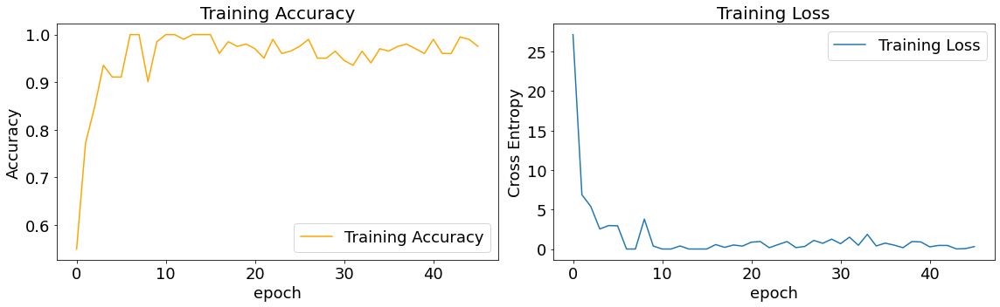

In [ ]:
acc = history.history['accuracy']+history_fine.history['accuracy']
loss = history.history['loss']+history_fine.history['loss']

fig,axes=plt.subplots(1,2,figsize=(16,5))
plt.rc('xtick',labelsize=8)


axes[0].plot(acc, label='Training Accuracy', color='#FFA500')
axes[0].tick_params(axis="x", labelsize=18)
axes[0].tick_params(axis="y", labelsize=18)

axes[0].legend(loc='lower right',fontsize=18)
axes[0].set_ylabel('Accuracy',fontsize=18)
axes[0].patch.set_facecolor("w")
axes[0].set_title('Training Accuracy',fontsize=20)
axes[0].set_xlabel('epoch',fontsize=18)
#axes[0].grid(None)

axes[0].spines['left'].set_color('black') 
axes[0].spines['bottom'].set_color('black') 
axes[0].spines['right'].set_color('black') 
axes[0].spines['top'].set_color('black')



axes[1].plot(loss, label='Training Loss')
axes[1].legend(loc='upper right',fontsize=18)
axes[1].set_ylabel('Cross Entropy',fontsize=18)
axes[1].patch.set_facecolor("w")
axes[1].set_title('Training Loss',fontsize=20)
axes[1].set_xlabel('epoch',fontsize=18)
#plt.grid(None)
axes[1].tick_params(axis="x", labelsize=18)
axes[1].tick_params(axis="y", labelsize=18)

axes[1].spines['left'].set_color('black') 
axes[1].spines['bottom'].set_color('black') 
axes[1].spines['right'].set_color('black') 
axes[1].spines['top'].set_color('black') 
plt.tight_layout()
plt.show()

[1 1 1 3 2 1 1 2 1 3 2 1 2 1 0 2 3 1 3 3 1 1 3 1 1 3 1 3 3 3 2 4 3 3 4 1 0
 4 0 0 2 3 0 3 4 3 2 2]
[1 1 1 3 2 1 1 2 0 3 2 1 2 1 0 2 3 1 3 3 1 1 3 1 1 3 1 3 3 3 2 4 3 3 4 1 0
 4 0 0 2 1 0 3 4 3 2 2]
0.9833333333333333
0.9583333333333334
0.9895833333333334
[1, 1, 1, 3, 2, 1, 1, 2, 0, 3, 2, 1, 2, 1, 0, 2, 3, 1, 3, 3, 1, 1, 3, 1, 1, 3, 1, 3, 3, 3, 2, 4, 3, 3, 4, 1, 0, 4, 0, 0, 2, 1, 0, 3, 4, 3, 2, 2]
[1, 1, 1, 3, 2, 1, 1, 2, 1, 3, 2, 1, 2, 1, 0, 2, 3, 1, 3, 3, 1, 1, 3, 1, 1, 3, 1, 3, 3, 3, 2, 4, 3, 3, 4, 1, 0, 4, 0, 0, 2, 3, 0, 3, 4, 3, 2, 2]


Text(0.5, 1.0, 'Confusion Matrix')

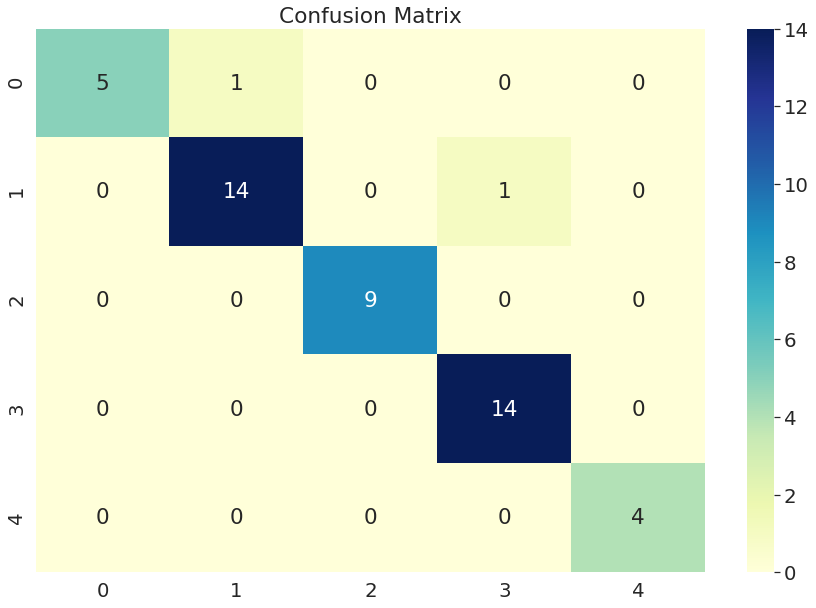

In [ ]:
import seaborn as sns;
from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plt
from sklearn.metrics import multilabel_confusion_matrix

probability_model = tf.keras.Sequential([model,tf.keras.layers.Softmax()])
predictions = probability_model.predict(Xtest)
#print(predictions)


FINNAL_CLASIFICATION=[]
for r in predictions:
 c=np.argmax(r)
 FINNAL_CLASIFICATION.append(c)
FINNAL_CLASIFICATION=np.array(FINNAL_CLASIFICATION)
print(FINNAL_CLASIFICATION)
print(Ytest)
C = multilabel_confusion_matrix(Ytest, FINNAL_CLASIFICATION)

tp = C[:, 1, 1]
tn = C[:, 0, 0]
fn = C[:, 1, 0]
fp = C[:, 0, 1]

acc=(sum(tn)+sum(tp))/(sum(tn)+ sum(fp)+ sum(fn)+sum(tp))
sen= sum(tp) / (sum(tp)+sum(fn))
spec = sum(tn) / (sum(tn) + sum(fp))
print(acc)
print(sen)
print(spec)
sns.set()
y_true = Ytest.tolist()
y_pred = FINNAL_CLASIFICATION.tolist()
plt.figure(figsize=(15, 10))
print(y_true)
print(y_pred)
C2= confusion_matrix(y_true, y_pred, labels=[0,1,2,3,4])
sns.set(font_scale=1.8)
sns.heatmap(C2,annot=True,cmap="YlGnBu")
plt.title('Confusion Matrix')


# view and fi

In [ ]:
import matplotlib.cm as cm
from tensorflow import keras

last_conv_layer_name = "Conv_1"
classifier_layer_names = [
    "global_average_pooling2d",
    "dense",
]

def make_gradcam_heatmap(
    img_array, model, last_conv_layer_name, classifier_layer_names
):
    # First, we create a model that maps the input image to the activations
    # of the last conv layer
    last_conv_layer = base_model.get_layer(last_conv_layer_name)
    last_conv_layer_model = keras.Model(base_model.inputs, last_conv_layer.output)

    # Second, we create a model that maps the activations of the last conv
    # layer to the final class predictions
    classifier_input = keras.Input(shape=last_conv_layer.output.shape[1:])
    x = classifier_input
    for layer_name in classifier_layer_names:
        x = model.get_layer(layer_name)(x)
    classifier_model = keras.Model(classifier_input, x)

    # Then, we compute the gradient of the top predicted class for our input image
    # with respect to the activations of the last conv layer
    with tf.GradientTape() as tape:
        # Compute activations of the last conv layer and make the tape watch it
        last_conv_layer_output = last_conv_layer_model(img_array)
        tape.watch(last_conv_layer_output)
        # Compute class predictions
        preds = classifier_model(last_conv_layer_output)
        top_pred_index = tf.argmax(preds[0])
        top_class_channel = preds[:, top_pred_index]

    # This is the gradient of the top predicted class with regard to
    # the output feature map of the last conv layer
    grads = tape.gradient(top_class_channel, last_conv_layer_output)

    # This is a vector where each entry is the mean intensity of the gradient
    # over a specific feature map channel
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))

    # We multiply each channel in the feature map array
    # by "how important this channel is" with regard to the top predicted class
    last_conv_layer_output = last_conv_layer_output.numpy()[0]
    pooled_grads = pooled_grads.numpy()
    for i in range(pooled_grads.shape[-1]):
        last_conv_layer_output[:, :, i] *= pooled_grads[i]

    # The channel-wise mean of the resulting feature map
    # is our heatmap of class activation
    heatmap = np.mean(last_conv_layer_output, axis=-1)

    # For visualization purpose, we will also normalize the heatmap between 0 & 1
    heatmap = np.maximum(heatmap, 0) / np.max(heatmap)
    return heatmap

In [ ]:
heatmaps=[]
for i in range(len(Xtest)):
  img_a=Xtest[i]
  img_a = np.expand_dims(img_a, axis=0)

  heatmap = make_gradcam_heatmap(img_a, model, last_conv_layer_name, classifier_layer_names)
  heatmaps.append(heatmap)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


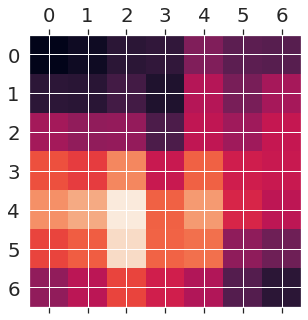

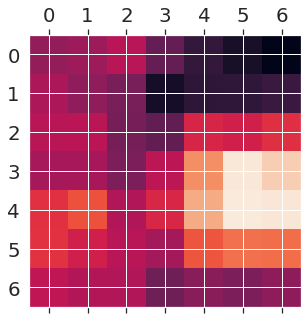

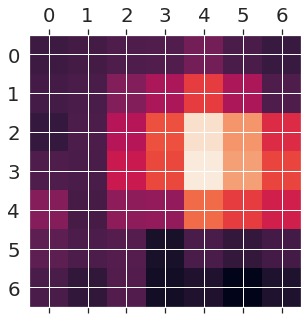

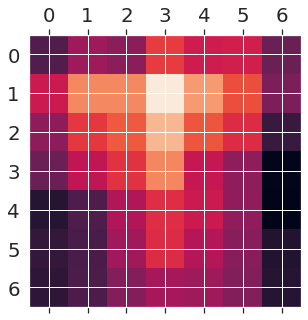

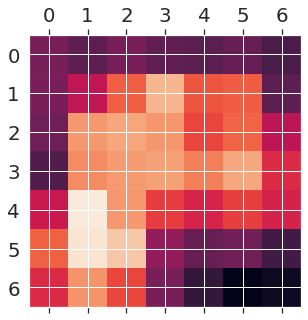

...

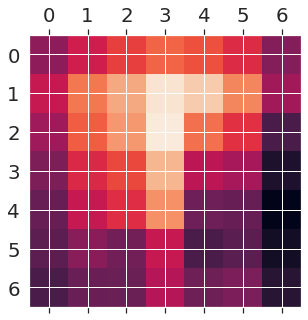

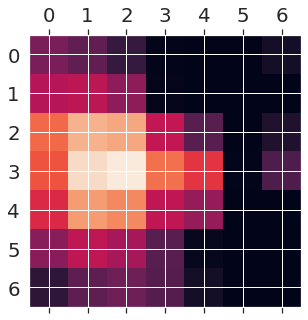

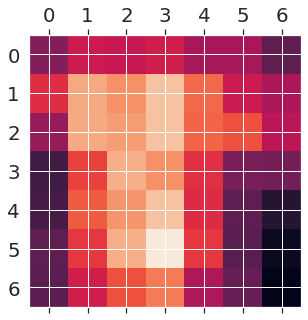

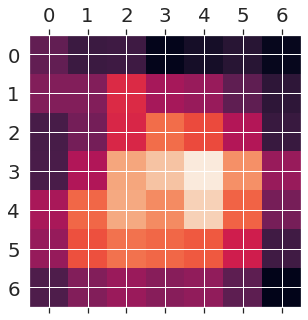

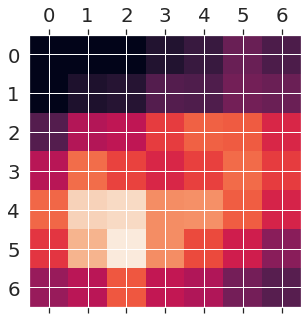

In [ ]:
for heatmap in heatmaps:
  fig, ax = plt.subplots(figsize=(10,5))
  ax.matshow(heatmap)


In [ ]:

def drawCAM(IMG,heatmap,y,count,row,colom):
  # We load the original image
  a=np.zeros((IMG.shape))
  a=IMG
  img = keras.preprocessing.image.img_to_array(a)

  # We rescale heatmap to a range 0-255
  heatmap = np.uint8(255 * heatmap)
  img=np.uint8(255 * img)
  # We use jet colormap to colorize heatmap
  jet = cm.get_cmap("jet")

  # We use RGB values of the colormap
  jet_colors = jet(np.arange(256))[:, :3]
  jet_heatmap = jet_colors[heatmap]

  # We create an image with RGB colorized heatmap
  jet_heatmap = keras.preprocessing.image.array_to_img(jet_heatmap)
  jet_heatmap = jet_heatmap.resize((img.shape[1], img.shape[0]))
  jet_heatmap = keras.preprocessing.image.img_to_array(jet_heatmap)

  # Superimpose the heatmap on original image
  superimposed_img = jet_heatmap+img
  superimposed_img = keras.preprocessing.image.array_to_img(superimposed_img)

  # Save the superimposed image


  # Display Grad CAM
  
  
  plt.title(str(y))
  plt.subplot(row,colom, count+1)
  plt.grid(False)
  sideimge=np.hstack([superimposed_img,img])
  plt.imshow(sideimge)
  print(sideimge.shape)
  plt.axis('off')
  
  return superimposed_img
  #
  #plt.imshow(img)
  #

In [ ]:

'''
count=0
plt.figure(figsize=(60, 65))
testedheats=[]
for img,heatmap,y in zip(Xtest,heatmaps,Ytest):
  
  testedheat=drawCAM(img,heatmap,y,count,10,5)
  testedheats.append(testedheat)
  plt.tight_layout()
  count=count+1
print(count)
'''

'\ncount=0\nplt.figure(figsize=(60, 65))\ntestedheats=[]\nfor img,heatmap,y in zip(Xtest,heatmaps,Ytest):\n  \n  testedheat=drawCAM(img,heatmap,y,count,10,5)\n  testedheats.append(testedheat)\n  plt.tight_layout()\n  count=count+1\nprint(count)\n'

In [ ]:
'''
id=0
print(FINNAL_CLASIFICATION)
for predlabel, trulabe in zip(FINNAL_CLASIFICATION,Ytest):
 
  if(predlabel!=trulabe):
    print("true lable: ",trulabe,"\npredicted label: ",predlabel)
    plt.imshow(testedheats[id])
    plt.grid(None)
    plt.show()
    plt.imshow(Xtest[id])
    
    plt.grid(None)
    
    plt.show()
    
  id=id+1
'''

'\nid=0\nprint(FINNAL_CLASIFICATION)\nfor predlabel, trulabe in zip(FINNAL_CLASIFICATION,Ytest):\n \n  if(predlabel!=trulabe):\n    print("true lable: ",trulabe,"\npredicted label: ",predlabel)\n    plt.imshow(testedheats[id])\n    plt.grid(None)\n    plt.show()\n    plt.imshow(Xtest[id])\n    \n    plt.grid(None)\n    \n    plt.show()\n    \n  id=id+1\n'

In [ ]:

base_model.trainable = True
print("Number of layers in the base model: ", len(base_model.layers))

# Fine-tune from this layer onwards
fine_tune_at = 152

# Freeze all the layers before the `fine_tune_at` layer
for layer in base_model.layers[:fine_tune_at]:
  layer.trainable =  False
model.compile(optimizer=tf.keras.optimizers.RMSprop(lr=base_learning_rate/10),
              loss=tf.keras.losses.CategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])
model.summary()
len(model.trainable_variables)
history = model.fit(X,Y,batch_size=4,epochs=30)
from sklearn.metrics import multilabel_confusion_matrix

probability_model = tf.keras.Sequential([model,tf.keras.layers.Softmax()])
predictions = probability_model.predict(Xtest)
#print(predictions)


FINNAL_CLASIFICATION=[]
for r in predictions:
 c=np.argmax(r)
 FINNAL_CLASIFICATION.append(c)
FINNAL_CLASIFICATION=np.array(FINNAL_CLASIFICATION)
print(FINNAL_CLASIFICATION)
print(Ytest)
C = multilabel_confusion_matrix(Ytest, FINNAL_CLASIFICATION)

tp = C[:, 1, 1]
tn = C[:, 0, 0]
fn = C[:, 1, 0]
fp = C[:, 0, 1]

acc=(sum(tn)+sum(tp))/(sum(tn)+ sum(fp)+ sum(fn)+sum(tp))
sen= sum(tp) / (sum(tp)+sum(fn))
spec = sum(tn) / (sum(tn) + sum(fp))
print(acc)
print(sen)
print(spec)


Number of layers in the base model:  154
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
mobilenetv2_1.00_224 (Functi (None, 7, 7, 1280)        2257984   
_________________________________________________________________
global_average_pooling2d (Gl (None, 1280)              0         
_________________________________________________________________
dense (Dense)                (None, 5)                 6405      
Total params: 2,264,389
Trainable params: 8,965
Non-trainable params: 2,255,424
_________________________________________________________________
Epoch 1/30
51/51 [==============================] - 2s 9ms/step - loss: 0.9396 - accuracy: 0.9614
Epoch 2/30
51/51 [==============================] - 0s 8ms/step - loss: 0.4374 - accuracy: 0.9734
Epoch 3/30
51/51 [==============================] - 0s 8ms/step - loss: 0.5600 - accuracy: 0.9848
Epoch 4/30
51/51 [===================

In [ ]:
### confusion matrix
"""
sns.set()
y_true = Ytest.tolist()
y_pred = FINNAL_CLASIFICATION.tolist()
plt.figure(figsize=(15, 10))
print(y_true)
print(y_pred)
C2= confusion_matrix(y_true, y_pred, labels=[0,1,2,3,4])
sns.set(font_scale=1.8)
sns.heatmap(C2,annot=True,cmap="YlGnBu")
plt.title('Confusion Matrix')
"""

## grad-cam

In [ ]:
print(FINNAL_CLASIFICATION)
print(Ytest)

[1 1 1 3 2 1 1 2 1 3 2 1 2 1 0 2 3 1 3 3 1 1 3 1 1 3 1 3 3 3 2 4 3 3 4 1 0
 4 0 0 2 3 0 3 4 3 2 2]
[1 1 1 3 2 1 1 2 0 3 2 1 2 1 0 2 3 1 3 3 1 1 3 1 1 3 1 3 3 3 2 4 3 3 4 1 0
 4 0 0 2 1 0 3 4 3 2 2]


(224, 448, 3)
(224, 448, 3)
(224, 448, 3)
(224, 448, 3)
(224, 448, 3)
(224, 448, 3)
6


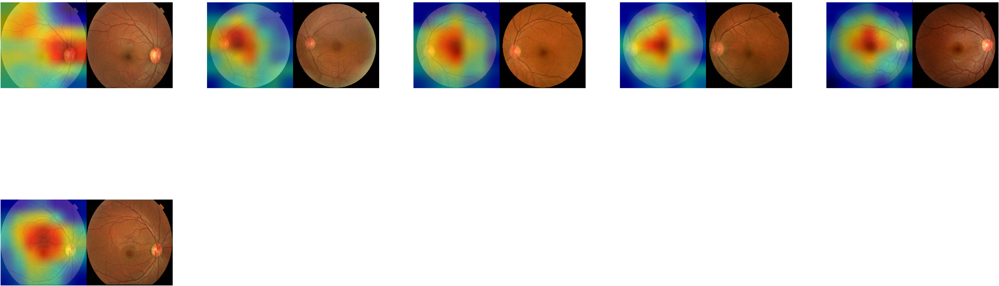

In [ ]:

count=0
testedheats=[]
plt.figure(figsize=(224, 448))
for img,heatmap,y in zip(Xtest,heatmaps,Ytest):
  if(y==0):
    
    testedheat=drawCAM(img,heatmap,y,count,10,5)
    count=count+1
print(count)   
    


(224, 448, 3)
(224, 448, 3)
(224, 448, 3)
(224, 448, 3)
(224, 448, 3)
(224, 448, 3)
(224, 448, 3)
(224, 448, 3)
(224, 448, 3)
(224, 448, 3)
(224, 448, 3)
(224, 448, 3)
(224, 448, 3)
(224, 448, 3)
(224, 448, 3)
15


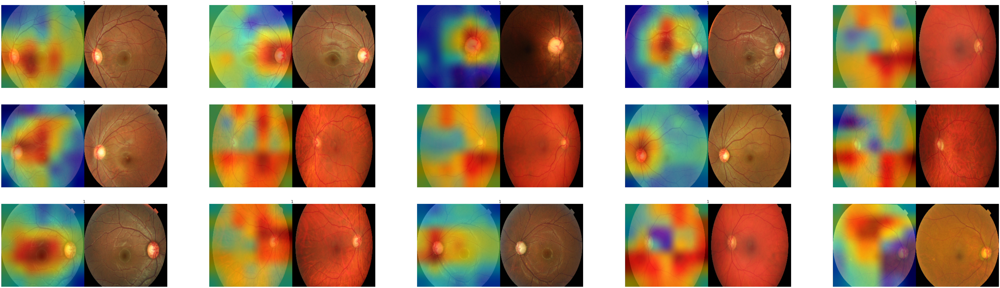

In [ ]:
plt.figure(figsize=(100, 100))
count=0
for img,heatmap,y in zip(Xtest,heatmaps,Ytest):
  if(y==1):
    
    testedheat=drawCAM(img,heatmap,y,count,10,5)
    count=count+1
print(count)    

(224, 448, 3)
(224, 448, 3)
(224, 448, 3)
(224, 448, 3)
(224, 448, 3)
(224, 448, 3)
(224, 448, 3)
(224, 448, 3)
(224, 448, 3)
9


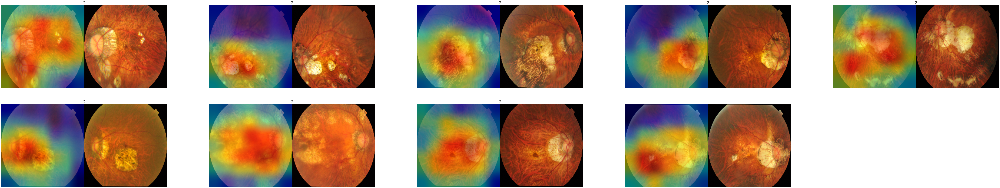

In [ ]:
plt.figure(figsize=(100, 100))
count=0
for img,heatmap,y in zip(Xtest,heatmaps,Ytest):
  if(y==2):
    
    testedheat=drawCAM(img,heatmap,y,count,10,5)
    count=count+1
print(count) 

(224, 448, 3)
(224, 448, 3)
(224, 448, 3)
(224, 448, 3)
(224, 448, 3)
(224, 448, 3)
(224, 448, 3)
(224, 448, 3)
(224, 448, 3)
(224, 448, 3)
(224, 448, 3)
(224, 448, 3)
(224, 448, 3)
(224, 448, 3)
14


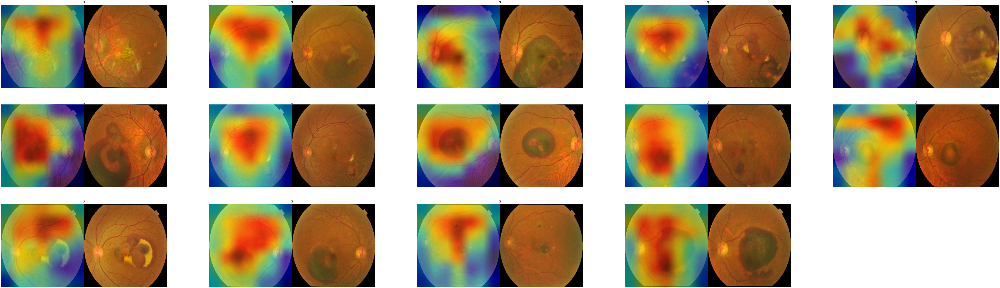

In [ ]:
plt.figure(figsize=(100, 100))
count=0
for img,heatmap,y in zip(Xtest,heatmaps,Ytest):
  if(y==3):
    
    testedheat=drawCAM(img,heatmap,y,count,10,5)
    count=count+1
print(count) 

(224, 448, 3)
(224, 448, 3)
(224, 448, 3)
(224, 448, 3)
4


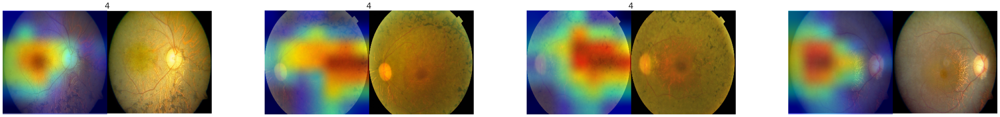

In [ ]:
plt.figure(figsize=(60, 60))
count=0
for img,heatmap,y in zip(Xtest,heatmaps,Ytest):
  if(y==4):
    
    testedheat=drawCAM(img,heatmap,y,count,10,5)
    count=count+1
print(count) 

# drawing

In [ ]:
plt.figure(figsize=(60, 60))
count=0
for img,heatmap,y in zip(Xtest,heatmaps,Ytest):
  if(y==4):
    
    testedheat=drawCAM(img,heatmap,y,count,10,5)
    count=count+1
print(count) 

Epoch 1/16
51/51 [==============================] - 3s 10ms/step - loss: 43.6462 - accuracy: 0.4438
Epoch 2/16
51/51 [==============================] - 0s 8ms/step - loss: 5.2651 - accuracy: 0.7691
Epoch 3/16
51/51 [==============================] - 0s 8ms/step - loss: 6.3853 - accuracy: 0.8288
Epoch 4/16
51/51 [==============================] - 0s 8ms/step - loss: 2.6481 - accuracy: 0.9220
Epoch 5/16
51/51 [==============================] - 0s 8ms/step - loss: 5.7189 - accuracy: 0.8910
Epoch 6/16
51/51 [==============================] - 0s 8ms/step - loss: 4.2512 - accuracy: 0.8655
Epoch 7/16
51/51 [==============================] - 0s 8ms/step - loss: 0.0010 - accuracy: 1.0000
Epoch 8/16
51/51 [==============================] - 0s 8ms/step - loss: 5.2180e-07 - accuracy: 1.0000
Epoch 9/16
51/51 [==============================] - 0s 8ms/step - loss: 2.7137 - accuracy: 0.9376
Epoch 10/16
51/51 [==============================] - 0s 8ms/step - loss: 0.4005 - accuracy: 0.9842
Epoch 11/16
51/51 [==============================] - 0s 8ms/step - loss: 9.0955e-08 - accuracy: 1.0000
Epoch 12/16
51/51 [==============================] - 0s 8ms/step - loss: 2.7491e-07 - accuracy: 1.0000
Epoch 13/16
51/51 [==============================] - 0s 8ms/step - loss: 0.0156 - accuracy: 0.9995
Epoch 14/16
51/51 [==============================] - 0s 8ms/step - loss: 6.9954e-10 - accuracy: 1.0000
Epoch 15/16
51/51 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - accuracy: 1.0000
Epoch 16/16
51/51 [==============================] - 0s 8ms/step - loss: 0.0000e+00 - accuracy: 1.0000








Epoch 1/30
51/51 [==============================] - 3s 8ms/step - loss: 0.6951 - accuracy: 0.9606
Epoch 2/30
51/51 [==============================] - 0s 8ms/step - loss: 0.0477 - accuracy: 0.9924
Epoch 3/30
51/51 [==============================] - 0s 8ms/step - loss: 0.2950 - accuracy: 0.9788
Epoch 4/30
51/51 [==============================] - 0s 8ms/step - loss: 0.4639 - accuracy: 0.9671
Epoch 5/30
51/51 [==============================] - 0s 9ms/step - loss: 0.5103 - accuracy: 0.9769
Epoch 6/30
51/51 [==============================] - 0s 9ms/step - loss: 0.3957 - accuracy: 0.9736
Epoch 7/30
51/51 [==============================] - 0s 8ms/step - loss: 0.0356 - accuracy: 0.9982
Epoch 8/30
51/51 [==============================] - 0s 8ms/step - loss: 0.3897 - accuracy: 0.9761
Epoch 9/30
51/51 [==============================] - 0s 8ms/step - loss: 0.5069 - accuracy: 0.9788
Epoch 10/30
51/51 [==============================] - 0s 8ms/step - loss: 0.1099 - accuracy: 0.9801
Epoch 11/30
51/51 [==============================] - 0s 8ms/step - loss: 0.1992 - accuracy: 0.9939
Epoch 12/30
51/51 [==============================] - 0s 8ms/step - loss: 0.9562 - accuracy: 0.9473
Epoch 13/30
51/51 [==============================] - 0s 8ms/step - loss: 0.5463 - accuracy: 0.9558
Epoch 14/30
51/51 [==============================] - 0s 8ms/step - loss: 0.3216 - accuracy: 0.9896
Epoch 15/30
51/51 [==============================] - 0s 8ms/step - loss: 0.5989 - accuracy: 0.9292
Epoch 16/30
51/51 [==============================] - 0s 8ms/step - loss: 1.8160 - accuracy: 0.9298
Epoch 17/30
51/51 [==============================] - 0s 8ms/step - loss: 0.2842 - accuracy: 0.9455
Epoch 18/30
51/51 [==============================] - 0s 8ms/step - loss: 3.9950 - accuracy: 0.9103
Epoch 19/30
51/51 [==============================] - 0s 8ms/step - loss: 0.2480 - accuracy: 0.9810
Epoch 20/30
51/51 [==============================] - 0s 8ms/step - loss: 0.3068 - accuracy: 0.9845
Epoch 21/30
51/51 [==============================] - 0s 8ms/step - loss: 0.3227 - accuracy: 0.9857
Epoch 22/30
51/51 [==============================] - 0s 8ms/step - loss: 0.1334 - accuracy: 0.9865
Epoch 23/30
51/51 [==============================] - 0s 8ms/step - loss: 0.2696 - accuracy: 0.9914
Epoch 24/30
51/51 [==============================] - 0s 8ms/step - loss: 0.3547 - accuracy: 0.9749
Epoch 25/30
51/51 [==============================] - 0s 8ms/step - loss: 0.7483 - accuracy: 0.9795
Epoch 26/30
51/51 [==============================] - 0s 8ms/step - loss: 0.4340 - accuracy: 0.9504
Epoch 27/30
51/51 [==============================] - 0s 8ms/step - loss: 0.3530 - accuracy: 0.9666
Epoch 28/30
51/51 [==============================] - 0s 8ms/step - loss: 0.0092 - accuracy: 0.9950
Epoch 29/30
51/51 [==============================] - 0s 8ms/step - loss: 0.0305 - accuracy: 0.9936
Epoch 30/30
51/51 [==============================] - 0s 8ms/step - loss: 0.7104 - accuracy: 0.9733

In [ ]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import os 
acc=[0.4438,
0.7691,
0.8288,
0.9220,
0.8910,
0.8655,
1.0000,
1.0000,
0.9376,
0.9842,
1.0000,
1.0000,
0.9995,
1.0000,
1.0000,
1.0000,
0.9924,
0.9788,
0.9671,
0.9769,
0.9736,
0.9982,
0.9761,
0.9788,
0.9801,
0.9939,
0.9473,
0.9558,
0.9896,
0.9292,
0.9298,
0.9455,
0.9103,
0.9810,
0.9845,
0.9857,
0.9865,
0.9914,
0.9749,
0.9795,
0.9504,
0.9666,
0.9950,
0.9936,
0.9733]




loss=[43.6462,5.2651,6.3853,2.6481,5.7189,4.7512,0.001,5.2180e-07,2.7137,0.4005,9.0955e-08,2.7491e-07,0.0156,6.9954e-10,0,0,0.6951,0.0477,0.2950,0.4639,0.5103,0.3957,0.0356,0.3897,0.5069,0.1099,0.1992,0.9562,
0.5463,
0.3216,
0.5989,
1.8160,
0.2842,
3.9950,
0.2480,
0.3068,
0.3227,
0.1334,
0.2696,
0.3547,
0.7483,
0.4340,
0.3530,
0.0092,
0.0305,
0.7104]
print(len(loss))

46


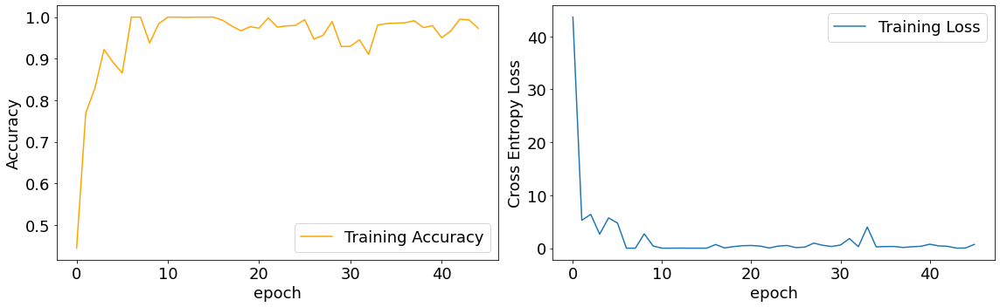

In [ ]:
#acc = history.history['accuracy']+history_fine.history['accuracy']
#loss = history.history['loss']+history_fine.history['loss']

fig,axes=plt.subplots(1,2,figsize=(16,5))
plt.rc('xtick',labelsize=8)


axes[0].plot(acc, label='Training Accuracy', color='#FFA500')
axes[0].tick_params(axis="x", labelsize=18)
axes[0].tick_params(axis="y", labelsize=18)

axes[0].legend(loc='lower right',fontsize=18)
axes[0].set_ylabel('Accuracy',fontsize=18)
axes[0].patch.set_facecolor("w")
#axes[0].set_title('Training Accuracy',fontsize=20)
axes[0].set_xlabel('epoch',fontsize=18)
#axes[0].grid(None)

axes[0].spines['left'].set_color('black') 
axes[0].spines['bottom'].set_color('black') 
axes[0].spines['right'].set_color('black') 
axes[0].spines['top'].set_color('black')



axes[1].plot(loss, label='Training Loss')
axes[1].legend(loc='upper right',fontsize=18)
axes[1].set_ylabel('Cross Entropy Loss',fontsize=18)
axes[1].patch.set_facecolor("w")
#axes[1].set_title('Training Loss',fontsize=20)
axes[1].set_xlabel('epoch',fontsize=18)
#plt.grid(None)
axes[1].tick_params(axis="x", labelsize=18)
axes[1].tick_params(axis="y", labelsize=18)

axes[1].spines['left'].set_color('black') 
axes[1].spines['bottom'].set_color('black') 
axes[1].spines['right'].set_color('black') 
axes[1].spines['top'].set_color('black') 
plt.tight_layout()
plt.show()